### November 2, 2020 Feature Engineering and Model Evaluation

#### Multi-class Classifier using Logistic Regression (One vs Rest classifier)

**X:** FDA (Chapter, Section, Subpart, cleaned description), Health Canada(Chapter, Section, Subpart, cleaned description)

**y:** Health Canada Code

In [1]:
import numpy as np
import pandas as pd

import warnings
warnings.filterwarnings("ignore")

from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score

import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

import seaborn as sns

from IPython.core.display import HTML as Center

Center(""" <style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style> """)

### Read CSV file

In [2]:
df_full = pd.read_csv('fda_matched_new.csv')
df_full.matched.value_counts()

1.0    7705
0.0     102
Name: matched, dtype: int64

In [3]:
# Export the regulation data which arent matched
fda_not_matched = df_full.loc[df_full['matched'] == 0.0]
fda_not_matched.to_csv('fda_not_matched.csv', index = False)

In [4]:
df_full = df_full.loc[df_full['matched'] == 1.0]
df_full = df_full.reset_index(drop=True)
df_full.drop(['FDA_Description','matched','score'], axis=1, inplace=True)

### Bipartite Graphs

In [5]:
data = df_full[['FDA_Code','HC_Code']]
print(data.shape)
data.head(3)

(7705, 2)


,FDA_Code,HC_Code
0,"""1.1""",B.01.008.1
1,"""1.3""",C.01.031
2,"""1.4""",A.01.062


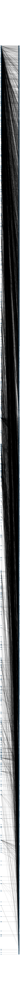

In [6]:
B = nx.Graph()
B.add_nodes_from(data['FDA_Code'], bipartite=0)
B.add_nodes_from(data['HC_Code'], bipartite=1)
B.add_weighted_edges_from(
    [(row['HC_Code'], row['FDA_Code'], 1) for idx, row in data.iterrows()], 
    weight='weight')

plt.figure(figsize=(10,500))

pos = {node:[0, i] for i,node in enumerate(data['HC_Code'])}
pos.update({node:[1, i] for i,node in enumerate(data['FDA_Code'])})
nx.draw(B, pos, with_labels=False)
for p in pos:  
    pos[p][1] += 0.25
nx.draw_networkx_labels(B, pos)

plt.show()

### Feature Engineering

In [7]:
reference_df = pd.DataFrame(list(zip(df_full.HC_Code.unique())), columns = ['HC_Code'])
reference_df['y'] = (reference_df.index).astype(str)
print(reference_df.shape)
reference_df.head(3)

(715, 2)


,HC_Code,y
0,B.01.008.1,0
1,C.01.031,1
2,A.01.062,2


In [8]:
df_full = df_full.merge(reference_df, on='HC_Code', how='left')
df_full.drop_duplicates(subset=df_full.columns, keep='last',inplace =True)
print(df_full.shape)
df_full.head(3)

(7705, 12)


,FDA_Chapter,FDA_Section,FDA_Code,FDA_Subpart,fda_desc_cleaned,HC_Code,HC_Chapter,HC_Section,HC_Subpart,HC_Description,hc_desc_cleaned,y
0,GENERAL ENFORCEMENT REGULATIONS,General Provisions,"""1.1""",General.,provision regulation promulgated federal food ...,B.01.008.1,Foods,General,General,(1) Information appearing on the label of a pr...,information appearing label prepackaged produc...,0
1,GENERAL ENFORCEMENT REGULATIONS,General Provisions,"""1.3""",Definitions.,labeling includes written printed graphic matt...,C.01.031,Drugs,Cautionary Statements and Child Resistant Pack...,Cautionary Statements and Child Resistant Pack...,"(1) Subject to section C.01.031.2, (a) no pers...",subject section c person shall sell drug descr...,1
2,GENERAL ENFORCEMENT REGULATIONS,General Provisions,"""1.4""",Authority citations.,part regulation food drug administration inclu...,A.01.062,Administration,Labelling of Food and Drugs in Pressurized Con...,Not Available,"(1) Subject to section A.01.063, if a food or ...",subject section food drug packaged container d...,2


In [9]:
X_ref = df_full[['FDA_Chapter','FDA_Section','FDA_Subpart','HC_Chapter','HC_Section','HC_Subpart','FDA_Code']]

# Categorical Features
X = df_full[['FDA_Chapter','FDA_Section','FDA_Subpart','HC_Chapter','HC_Section','HC_Subpart']]
X = pd.get_dummies(data = X_ref, columns = X_ref.columns)

# Textual Features
tfidf_vectorizer = TfidfVectorizer()
X_text = df_full[['hc_desc_cleaned','fda_desc_cleaned']]
X_ref = pd.concat([X_ref, X_text], axis=1, sort=True)
X_text['hc_desc_cleaned'] = tfidf_vectorizer.fit_transform(X_text['hc_desc_cleaned']).toarray()
X_text['fda_desc_cleaned'] = tfidf_vectorizer.fit_transform(X_text['fda_desc_cleaned']).toarray()

# X
X = pd.concat([X, X_text], axis=1, sort=True)

# y
y = df_full.y

# Train Test Split
X_ref_train, X_ref_test, y_ref_train, y_ref_test = train_test_split(X_ref, y, test_size = 0.2, random_state = 42)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

print('X_train:',X_train.shape)
print('y_train:', y_train.shape)
print('X_test:',X_test.shape)
print('y_test:',y_test.shape)

print('X_ref_train:',X_ref_train.shape)
print('y_ref_train:',y_ref_train.shape)
print('X_ref_test:',X_ref_test.shape)
print('y_ref_test:',y_ref_test.shape)

X_train: (6164, 16041)
y_train: (6164,)
X_test: (1541, 16041)
y_test: (1541,)
X_ref_train: (6164, 9)
y_ref_train: (6164,)
X_ref_test: (1541, 9)
y_ref_test: (1541,)


### Classifier: Logistic Regression (One vs Rest multi-class classifier) and Random Forest Classifier

In [10]:
print('---------- Logistic Regression ----------')
lr = LogisticRegression(multi_class='ovr')
lr.fit(X_train, y_train)
lr_predictions = lr.predict(X_test)

lr_f1 = metrics.f1_score(y_test, lr_predictions, average = 'micro') 
print('F1 Score:',round(lr_f1,4))

lr_ck = cohen_kappa_score(y_test, lr_predictions)
print('Cohen Kappa Score:',round(lr_ck,4))

lr_hamm_loss = metrics.hamming_loss(y_test, lr_predictions)
print('Hamming Loss:', round(lr_hamm_loss,4))

print('---------- Random Forest Classifier ----------')
rf = RandomForestClassifier(n_estimators = 100, random_state=42).fit(X_train, y_train) 
rf_predictions = rf.predict(X_test) 

rf_f1 = metrics.f1_score(y_test, rf_predictions, average = 'micro') 
print('F1 Score:',round(rf_f1,4))

rf_ck = cohen_kappa_score(y_test, rf_predictions)
print('Cohen Kappa Score:',round(rf_ck,4))

rf_hamm_loss = metrics.hamming_loss(y_test, rf_predictions)
print('Hamming Loss:', round(rf_hamm_loss,4))


---------- Logistic Regression ----------
F1 Score: 0.6613
Cohen Kappa Score: 0.6571
Hamming Loss: 0.3387
---------- Random Forest Classifier ----------
F1 Score: 0.6781
Cohen Kappa Score: 0.6743
Hamming Loss: 0.3219


In [11]:
# Print the coefficients for Logistic Regression
coeff = pd.DataFrame(zip(X_train.columns.values, lr.coef_[0]))
coeff.rename(columns = {0:'Feature',
                       1:'Coefficient'}, inplace = True) 
coeff['log_odds'] = np.exp(coeff['Coefficient'])
print(coeff.shape)
coeff

(16041, 3)


,Feature,Coefficient,log_odds
0,FDA_Chapter_ACIDIFIED FOODS,-0.003008,0.996997
1,FDA_Chapter_ADDITIONAL STANDARDS FOR DIAGNOSTI...,-0.002568,0.997435
2,FDA_Chapter_ADDITIONAL STANDARDS FOR HUMAN BLO...,0.676905,1.967778
3,FDA_Chapter_ADDITIONAL STANDARDS FOR MISCELLAN...,-0.000370,0.999630
4,"FDA_Chapter_ADMINISTRATIVE FUNCTIONS, PRACTICE...",-0.010261,0.989791
...,...,...,...
16036,"FDA_Code_""99.403""",-0.000140,0.999860
16037,"FDA_Code_""99.405""",-0.000133,0.999867
16038,"FDA_Code_""99.501""",-0.000120,0.999880
16039,hc_desc_cleaned,-0.025053,0.975258


In [12]:
sig = coeff.loc[coeff['Coefficient'] == 0.0]
sig

,Feature,Coefficient,log_odds
52,FDA_Chapter_DIETARY SUPPLEMENTS,0.0,1.0
53,FDA_Chapter_DIETARY SUPPLEMENTS THAT PRESENT A...,0.0,1.0
82,FDA_Chapter_FRUIT PIES,0.0,1.0
166,FDA_Chapter_PRESCRIPTION DRUG ADVERTISING,0.0,1.0
173,FDA_Chapter_QUALIFYING PATHOGENS,0.0,1.0
...,...,...,...
16002,"FDA_Code_""895.25""",0.0,1.0
16003,"FDA_Code_""895.30""",0.0,1.0
16015,"FDA_Code_""900.22""",0.0,1.0
16018,"FDA_Code_""900.25""",0.0,1.0


#### Feature Importance
It is an impurity-based feature importances.

The higher, the more important the feature. The importance of a feature is computed as the (normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance.The importance scores can highlight which features may be most relevant to the target, and the converse, which features are the least relevant.

In [13]:
# get importance for Random Forest
importance = pd.DataFrame(rf.feature_importances_)

In [14]:
result = pd.concat([coeff, importance], axis=1, sort=False)
result.rename(columns = {0:'Feature_Importance'}, inplace = True) 
result

,Feature,Coefficient,log_odds,Feature_Importance
0,FDA_Chapter_ACIDIFIED FOODS,-0.003008,0.996997,0.000160
1,FDA_Chapter_ADDITIONAL STANDARDS FOR DIAGNOSTI...,-0.002568,0.997435,0.000345
2,FDA_Chapter_ADDITIONAL STANDARDS FOR HUMAN BLO...,0.676905,1.967778,0.001344
3,FDA_Chapter_ADDITIONAL STANDARDS FOR MISCELLAN...,-0.000370,0.999630,0.000034
4,"FDA_Chapter_ADMINISTRATIVE FUNCTIONS, PRACTICE...",-0.010261,0.989791,0.000544
...,...,...,...,...
16036,"FDA_Code_""99.403""",-0.000140,0.999860,0.000045
16037,"FDA_Code_""99.405""",-0.000133,0.999867,0.000072
16038,"FDA_Code_""99.501""",-0.000120,0.999880,0.000055
16039,hc_desc_cleaned,-0.025053,0.975258,0.006105


### Evaluation on test set

In [15]:
# tabulating predictions and corresponding predicted Health Canada Code
predictions = pd.DataFrame(rf_predictions)
predictions.rename(columns = {0:'y_Predicted'}, inplace = True) 
predictions = predictions.merge(reference_df, left_on='y_Predicted', right_on='y', how='left').rename(columns={'HC_Code':'HC_Code_Predicted'})
predictions.drop(['y'], axis=1,inplace=True)
predictions

,y_Predicted,HC_Code_Predicted
0,398,B.02.133
1,411,B.01.091
2,63,J.01.082
3,4,C.01.029
4,221,B.12.001
...,...,...
1536,182,B.10.005
1537,50,J.01.087
1538,8,C.01A.001
1539,360,B.10.026


In [16]:
# adding the prediction to test set
prediction_results = X_ref_test.copy()
prediction_results.reset_index(drop=True,inplace=True)
prediction_results = prediction_results.merge(predictions, left_index=True, right_index=True)
print(prediction_results.shape)
prediction_results.head(3)

(1541, 11)


,FDA_Chapter,FDA_Section,FDA_Subpart,HC_Chapter,HC_Section,HC_Subpart,FDA_Code,hc_desc_cleaned,fda_desc_cleaned,y_Predicted,HC_Code_Predicted
0,SUBSTANCES GENERALLY RECOGNIZED AS SAFE,Chemical Preservatives,Ascorbyl palmitate.,Foods,Alcoholic Beverages,Beer,"""182.3149""",hop extract hexane methanol methylene chloride...,product ascorbyl palmitate condition use subst...,398,B.02.133
1,FOOD ADDITIVES PERMITTED IN FEED AND DRINKING ...,Food Additive Listing,Disodium EDTA.,Foods,General,General,"""573.360""",standard food prescribed part food shall conta...,food additive disodium edta may safely used an...,411,B.01.091
2,CURRENT GOOD MANUFACTURING PRACTICE IN MANUFAC...,Production and Process Control System: Require...,"Under this subpart J, what records must you ma...",Restricted Drugs,Documents,Drug Received for Identification and Analysis,"""111.325""",method recording information person record inf...,must make keep record required subpart j accor...,63,J.01.082


In [17]:
prediction_results.drop(['y_Predicted'],axis=1,inplace=True)

In [18]:
prediction_results.to_csv('predicted_HCCodes.csv',index=False)

In [19]:
# Check predictions for FDA_Code = 211.42
prediction_results.drop(['hc_desc_cleaned','fda_desc_cleaned'],axis=1,inplace=True)
prediction_results.loc[prediction_results['FDA_Code'] == '"211.42"']

,FDA_Chapter,FDA_Section,FDA_Subpart,HC_Chapter,HC_Section,HC_Subpart,FDA_Code,HC_Code_Predicted


In [20]:
# Check predictions for FDA_Code = 211.63
prediction_results.loc[prediction_results['FDA_Code'] == '"211.56"']

,FDA_Chapter,FDA_Section,FDA_Subpart,HC_Chapter,HC_Section,HC_Subpart,FDA_Code,HC_Code_Predicted


In [ ]:
prediction_results.loc[prediction_results['FDA_Code'] == '"211.84"']

In [23]:
result1 = prediction_results.loc[prediction_results['FDA_Code'] == '"211.67"']
# result1.drop(['hc_desc_cleaned','fda_desc_cleaned'], axis=1, inplace=True)
result1

,FDA_Chapter,FDA_Section,FDA_Subpart,HC_Chapter,HC_Section,HC_Subpart,FDA_Code,HC_Code_Predicted
500,CURRENT GOOD MANUFACTURING PRACTICE FOR FINISH...,Equipment,Equipment cleaning and maintenance.,Drugs,Good Manufacturing Practices,Premises,"""211.67""",C.02.004


In [25]:
result2 = prediction_results.loc[prediction_results['FDA_Code'] == '"211.25"']
# result2.drop(['hc_desc_cleaned','fda_desc_cleaned'], axis=1, inplace=True)
result2

,FDA_Chapter,FDA_Section,FDA_Subpart,HC_Chapter,HC_Section,HC_Subpart,FDA_Code,HC_Code_Predicted
573,CURRENT GOOD MANUFACTURING PRACTICE FOR FINISH...,Organization and Personnel,Personnel qualifications.,Controlled Drugs,Pharmacists,General Obligations of Pharmacist,"""211.25""",G.03.011


In [26]:
result3 = prediction_results.loc[prediction_results['FDA_Code'] == '"211.63"']
# result3.drop(['hc_desc_cleaned','fda_desc_cleaned'], axis=1, inplace=True)
result3

,FDA_Chapter,FDA_Section,FDA_Subpart,HC_Chapter,HC_Section,HC_Subpart,FDA_Code,HC_Code_Predicted
1236,CURRENT GOOD MANUFACTURING PRACTICE FOR FINISH...,Equipment,"Equipment design, size, and location.",Drugs,Good Manufacturing Practices,Equipment,"""211.63""",C.02.005
